In [2]:
%matplotlib inline

%load_ext autoreload
%autoreload 2

In [3]:
import os

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_context('notebook')
import numpy as np
import pandas as pd
from astropy.table import Table  # just to read fits

In [4]:
os.chdir('/home/walml/repos/zoobot')

In [6]:
# ml_loc = 'results/temp/decals_n2_allq_m0_all_mean.csv'  # load the predictions (only one model here)
# ml = pd.read_csv(ml_loc)
ml = pd.read_parquet('final_ml_catalog.parquet')
print('Galaxies with ML predictions: ' + str(len(ml)))
ml['bar_any_fraction'] = ml['bar_strong_fraction'] + ml['bar_weak_fraction']

Galaxies with ML predictions: 313789


In [7]:
# also add in the NSA catalog values, for redshift

In [8]:
nsa = Table.read('/media/walml/beta/galaxy_zoo/decals/catalogs/nsa_v1_0_0_decals_dr5.fits')

In [9]:
# usually I just pull out the useful columns and merge straight away, but this can cause endian problems
nsa_iaunames = list(nsa['iauname'])
nsa_redshifts = list(nsa['z'])
# nsa_df = nsa[['iauname', 'z']].to_pandas()


In [10]:
nsa_df = pd.DataFrame(data={'iauname': nsa_iaunames, 'redshift': nsa_redshifts})


In [11]:
ml = pd.merge(ml, nsa_df, on='iauname', how='inner')
len(ml)

309067

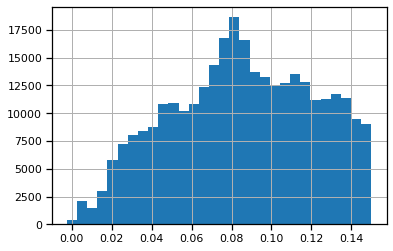

In [12]:
ml['redshift'].hist(bins=30)

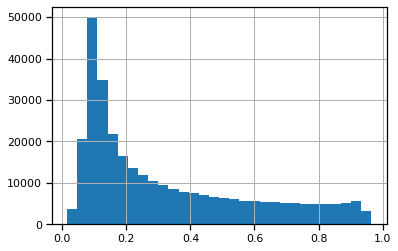

In [13]:
ml['smooth-or-featured_featured-or-disk_fraction'].hist(bins=30)

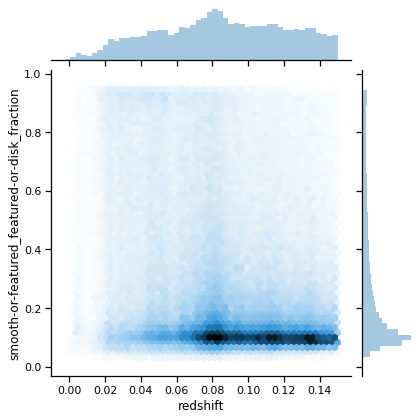

In [14]:
sns.jointplot(data=ml, x='redshift', y='smooth-or-featured_featured-or-disk_fraction', kind='hex')

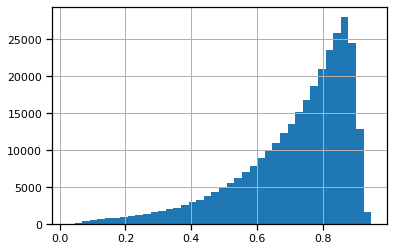

In [15]:
ml['merging_none_fraction'].hist(bins=40)

In [16]:


featured = ml['smooth-or-featured_featured-or-disk_fraction'] > 0.43
not_edge_on = ml['disk-edge-on_no_fraction'] > 0.715
spiral = ml['has-spiral-arms_yes_fraction'] > 0.619

not_weird = ml['merging_none_fraction'] > 0.5

ml_sample = ml[featured & not_edge_on & spiral & not_weird]
print(f'Selected {len(ml_sample)} of {len(ml)} galaxies ({len(ml_sample) / len(ml)})')

def add_masters_derived_columns(df): 
    df['winding_eqn_1'] = df['spiral-winding_tight_fraction'] + 0.5 * df['spiral-winding_medium_fraction']
    df['bulge_eqn_3'] = 0.25 * df['bulge-size_small_fraction'] + 0.5 * df['bulge-size_moderate_fraction'] + 0.75 * df['bulge-size_large_fraction'] + df['bulge-size_dominant_fraction']
     # modifies df inplace
        
add_masters_derived_columns(ml_sample)

Selected 43550 of 309067 galaxies (0.1409079584685521)


/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


In [17]:
ml['smooth-or-featured_featured-or-disk_fraction'].max(), ml_sample['smooth-or-featured_featured-or-disk_fraction'].max()

(0.9647598188783139, 0.9647598188783139)

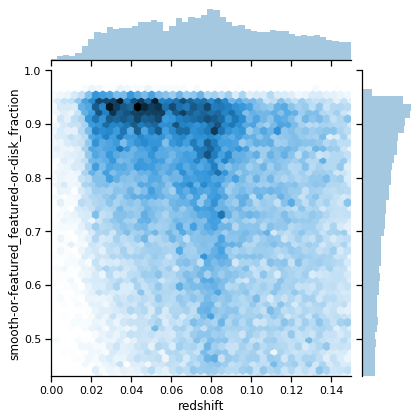

In [18]:
sns.jointplot(data=ml_sample, x='redshift', y='smooth-or-featured_featured-or-disk_fraction', kind='hex', xlim=[0., 0.15], ylim=[0.43, 1.])

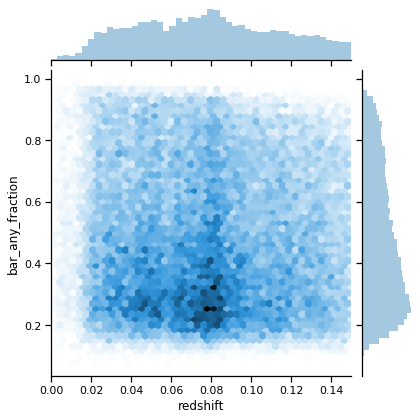

In [19]:
sns.jointplot(data=ml_sample, x='redshift', y='bar_any_fraction', kind='hex', xlim=[0., 0.15])

In [20]:
df = ml_sample  # for conciseness

(0.0, 1.0)

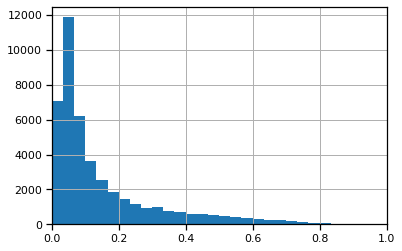

In [21]:
df['bar_strong_fraction'].hist(bins=30, range=(0., 1.))
plt.xlim(0., 1.)

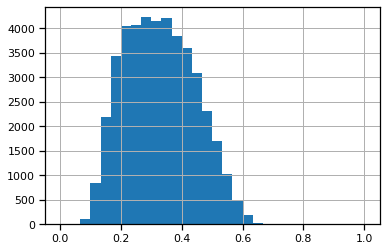

In [22]:
df['bar_weak_fraction'].hist(bins=30, range=(0., 1.))

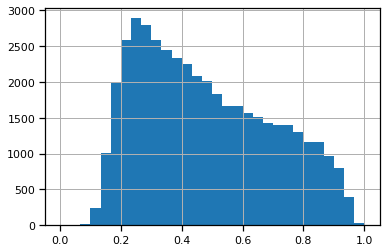

In [23]:

df['bar_any_fraction'].hist(bins=30, range=(0., 1.))

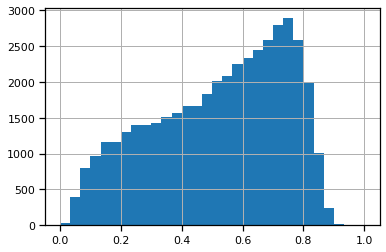

In [24]:
df['bar_no_fraction'].hist(bins=30, range=(0., 1.))

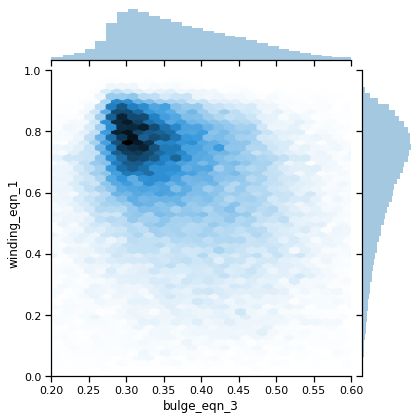

In [25]:
sns.jointplot(ml_sample['bulge_eqn_3'], ml_sample['winding_eqn_1'], kind='hex', xlim=[.2, .6], ylim=[0., 1.])

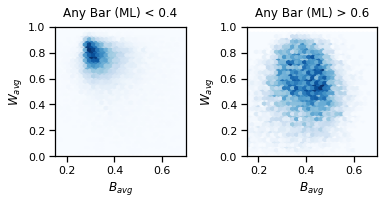

In [26]:
# sns.set_context('talk')
sns.set_context('notebook')
sns.set_palette('Blues')
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(5.5, 3))
# spiral_2 = df_f['spiral-arm-count_2_fraction'] > 0.8
spiral_2 = np.ones(len(df)).astype(bool)
no_bar = df[spiral_2].query('bar_any_fraction < 0.4')
bar = df[spiral_2].query('bar_any_fraction > 0.6')
alpha = .01
# sns.scatterplot(no_bar['bulge_eqn_3'], no_bar['winding_eqn_1'], ax=ax0, alpha=alpha)
# sns.scatterplot(bar['bulge_eqn_3'], bar['winding_eqn_1'], ax=ax1, alpha=alpha)
# sns.kdeplot(no_bar['bulge_eqn_3'], no_bar['winding_eqn_1'], ax=ax0, shade=True, shade_lowest=False)
# sns.kdeplot(bar['bulge_eqn_3'], bar['winding_eqn_1'], ax=ax1, shade=True, shade_lowest=False)
gridsize = 40
ax0.hexbin(no_bar['bulge_eqn_3'], no_bar['winding_eqn_1'], cmap=plt.get_cmap('Blues'), gridsize=gridsize)
ax1.hexbin(bar['bulge_eqn_3'], bar['winding_eqn_1'], cmap=plt.get_cmap('Blues'), gridsize=gridsize)
xlim = [.15, .7]
ax0.set_xlim(xlim)
ax0.set_ylim([0, 1])
ax1.set_xlim(xlim)
ax1.set_ylim([0, 1])
ax0.set_ylabel(r'$W_{avg}$')
ax0.set_xlabel(r'$B_{avg}$')
ax1.set_xlabel(r'$B_{avg}$')
ax1.set_ylabel(r'$W_{avg}$')
ax0.set_title(f'Any Bar (ML) < 0.4', pad=10.)
ax1.set_title(f'Any Bar (ML) > 0.6', pad=10.)
# ax0.set_title(f'Any Bar (ML) < 0.4 (N={len(no_bar)})', pad=15.)
# ax1.set_title(f'Any Bar (ML) > 0.6 (N={len(bar)})', pad=15.)
fig.tight_layout()
fig.savefig('m19_bar_split.pdf')

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


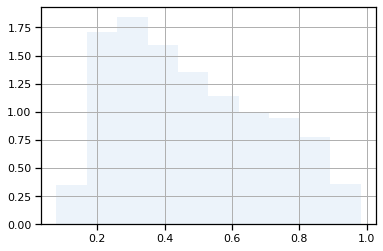

In [27]:
df[spiral_2]['bar_any_fraction'].hist(alpha=.5, density=True)
df[~spiral_2]['bar_any_fraction'].hist(alpha=.5, density=True)

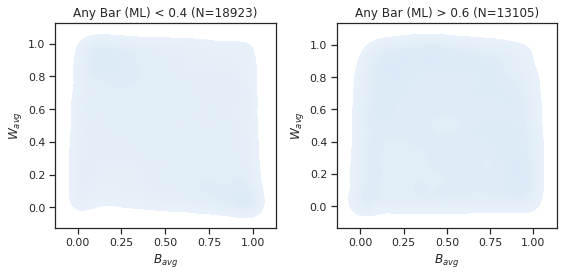

In [49]:
sns.set_style('ticks')
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(8, 4))
no_bar = df.query('bar_any_fraction < 0.4')
bar = df.query('bar_any_fraction > 0.6')
sns.kdeplot(no_bar['bulge_eqn_3'].rank(pct=True), no_bar['winding_eqn_1'].rank(pct=True), ax=ax0, shade=True, shade_lowest=False)
sns.kdeplot(bar['bulge_eqn_3'].rank(pct=True), bar['winding_eqn_1'].rank(pct=True), ax=ax1, shade=True, shade_lowest=False)
# ax0.set_xlim([0, 1])
# ax0.set_ylim([0, 1])
# ax1.set_xlim([0, 1])
# ax1.set_ylim([0, 1])
ax0.set_ylabel(r'$W_{avg}$')
ax0.set_xlabel(r'$B_{avg}$')
ax1.set_xlabel(r'$B_{avg}$')
ax1.set_ylabel(r'$W_{avg}$')
ax0.set_title(f'Any Bar (ML) < 0.4 (N={len(no_bar)})')
ax1.set_title(f'Any Bar (ML) > 0.6 (N={len(bar)})')
fig.tight_layout()

In [29]:
df['winding_eqn_1_pc'] = df['winding_eqn_1'].rank(pct=True)
# df_f['winding_eqn_1_pc'] = df_f['winding_eqn_1'].rank(pct=True)

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [30]:
df['winding_eqn_1_pc']

17        0.012331
19        0.151711
25        0.428266
35        0.245098
36        0.703582
            ...   
309033    0.249782
309036    0.667577
309046    0.330700
309056    0.563972
309066    0.929713
Name: winding_eqn_1_pc, Length: 43550, dtype: float64

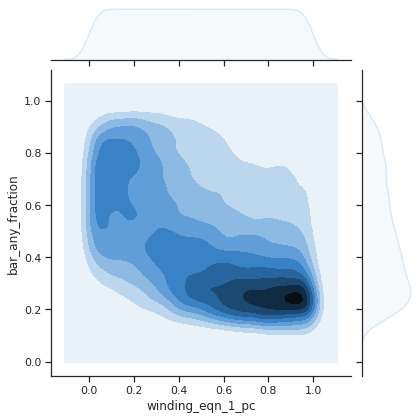

In [31]:
sns.jointplot(df['winding_eqn_1_pc'], df['bar_any_fraction'], kind='kde')

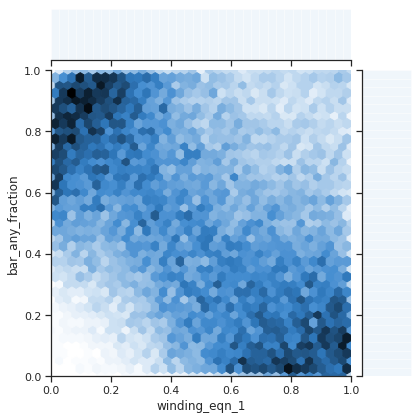

In [32]:
sns.jointplot(df['winding_eqn_1'].rank(pct=True), df['bar_any_fraction'].rank(pct=True), kind='hex', xlim=[0., 1.], ylim=[0., 1.])

Text(0, 0.5, ' Bar "any" percentile')

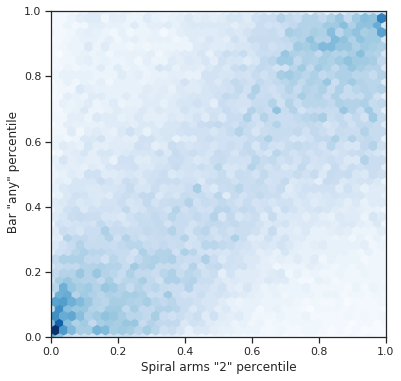

In [33]:
plt.figure(figsize=(6, 6))
plt.hexbin(df['spiral-arm-count_2_fraction'].rank(pct=True), df['bar_any_fraction'].rank(pct=True), cmap=plt.get_cmap('Blues'), gridsize=40, bins=50)
plt.xlim(0., 1.)
plt.ylim(0., 1.)
plt.xlabel('Spiral arms "2" percentile')
plt.ylabel(r' Bar "any" percentile')

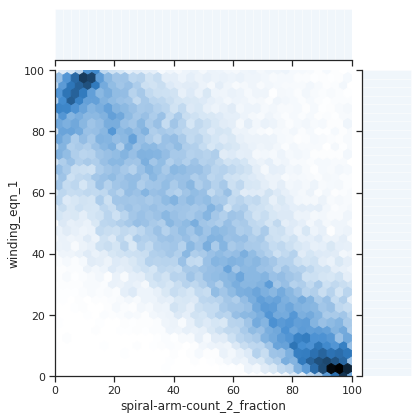

In [34]:
sns.jointplot(df['spiral-arm-count_2_fraction'].rank(pct=True) * 100, df['winding_eqn_1'].rank(pct=True) * 100, kind='hex', xlim=[0., 100.], ylim=[0., 100.])

In [35]:
from matplotlib.colors import Normalize
import matplotlib.ticker as ticker

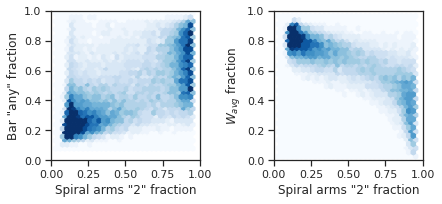

In [36]:
sns.set_context('notebook')
# sns.jointplot(df['spiral-arm-count_2_fraction'].rank(pct=True) * 100, df['winding_eqn_1'].rank(pct=True) * 100, kind='hex', xlim=[0., 100.], ylim=[0., 100.])
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(6.3, 3))
ax0.hexbin(df['spiral-arm-count_2_fraction'], df['bar_any_fraction'], cmap=plt.get_cmap('Blues'), gridsize=30, bins=50, norm=Normalize(vmin=1, vmax=20))
ax1.hexbin(df['spiral-arm-count_2_fraction'], df['winding_eqn_1'], cmap=plt.get_cmap('Blues'), gridsize=30, bins=50, norm=Normalize(vmin=1, vmax=20))

ax0.set_xlabel('Spiral arms "2" fraction')
ax1.set_xlabel('Spiral arms "2" fraction')
ax0.set_ylabel(r'Bar "any" fraction')
ax1.set_ylabel(r'$W_{avg}$ fraction')

ax0.set_xlim(0., 1.)
ax0.set_ylim(0., 1.)

ax1.set_xlim(0., 1.)
ax1.set_ylim(0., 1.)

fig.tight_layout()
fig.savefig('spiral_correlations_fractions.pdf')

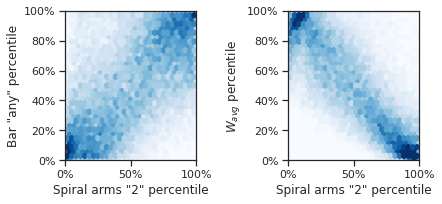

In [37]:
sns.set_context('notebook')
# sns.jointplot(df['spiral-arm-count_2_fraction'].rank(pct=True) * 100, df['winding_eqn_1'].rank(pct=True) * 100, kind='hex', xlim=[0., 100.], ylim=[0., 100.])
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(6.3, 3))
ax0.hexbin(df['spiral-arm-count_2_fraction'].rank(pct=True), df['bar_any_fraction'].rank(pct=True), cmap=plt.get_cmap('Blues'), gridsize=30, bins=50, norm=Normalize(vmin=1, vmax=30))
ax1.hexbin(df['spiral-arm-count_2_fraction'].rank(pct=True), df['winding_eqn_1'].rank(pct=True), cmap=plt.get_cmap('Blues'), gridsize=30, bins=50, norm=Normalize(vmin=1, vmax=30))

ax0.set_xlabel('Spiral arms "2" percentile')
ax1.set_xlabel('Spiral arms "2" percentile')
ax0.set_ylabel(r'Bar "any" percentile')
ax1.set_ylabel(r'$W_{avg}$ percentile')

ax0.xaxis.set_major_formatter(ticker.PercentFormatter(xmax=1))
ax0.yaxis.set_major_formatter(ticker.PercentFormatter(xmax=1))
ax1.xaxis.set_major_formatter(ticker.PercentFormatter(xmax=1))
ax1.yaxis.set_major_formatter(ticker.PercentFormatter(xmax=1))

ax0.set_xlim(0., 1.)
ax0.set_ylim(0., 1.)

ax1.set_xlim(0., 1.)
ax1.set_ylim(0., 1.)

fig.tight_layout()
fig.savefig('spiral_correlations_percentiles.pdf')

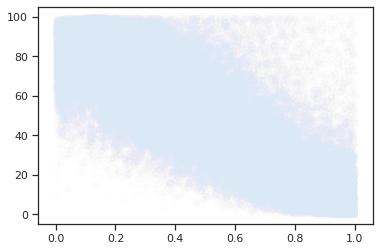

In [38]:
sns.set_style('ticks')
plt.scatter(df['spiral-arm-count_2_fraction'].rank(pct=True), df['winding_eqn_1'].rank(pct=True) * 100, alpha=.01)

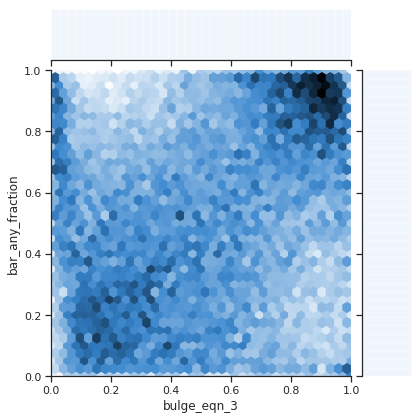

In [39]:
sns.jointplot(df['bulge_eqn_3'].rank(pct=True), df['bar_any_fraction'].rank(pct=True), kind='hex', xlim=[0., 1.], ylim=[0., 1.])

In [40]:
from zoobot.estimators import losses
from zoobot import label_metadata

In [41]:
schema = losses.Schema(label_metadata.decals_label_cols, label_metadata.decals_questions, version='decals')

{smooth-or-featured, indices 0 to 2, asked after None: (0, 2), disk-edge-on, indices 3 to 4, asked after smooth-or-featured_featured-or-disk, index 1: (3, 4), has-spiral-arms, indices 5 to 6, asked after disk-edge-on_no, index 4: (5, 6), bar, indices 7 to 9, asked after disk-edge-on_no, index 4: (7, 9), bulge-size, indices 10 to 14, asked after disk-edge-on_no, index 4: (10, 14), how-rounded, indices 15 to 17, asked after smooth-or-featured_smooth, index 0: (15, 17), edge-on-bulge, indices 18 to 20, asked after disk-edge-on_yes, index 3: (18, 20), spiral-winding, indices 21 to 23, asked after has-spiral-arms_yes, index 5: (21, 23), spiral-arm-count, indices 24 to 29, asked after has-spiral-arms_yes, index 5: (24, 29), merging, indices 30 to 33, asked after None: (30, 33)}


In [42]:
spiral_count_cols = [a.text for a in schema.get_question('spiral-arm-count').answers]

In [43]:
spiral_count_cols[:4]  # 1/2/3/4

['spiral-arm-count_1',
 'spiral-arm-count_2',
 'spiral-arm-count_3',
 'spiral-arm-count_4']

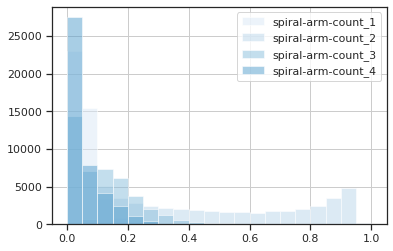

In [44]:
for col in spiral_count_cols[:4]:
    df[col + '_fraction'].hist(bins=20, range=[0., 1.], alpha=.5, label=col)
plt.legend()

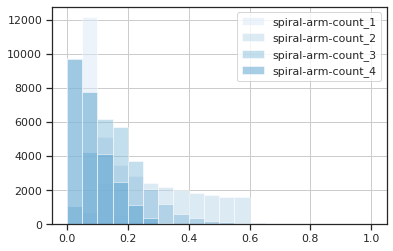

In [45]:
for col in spiral_count_cols[:4]:
    df[df['spiral-arm-count_2_fraction'] < 0.6][col + '_fraction'].hist(bins=20, range=[0., 1.], alpha=.5, label=col)
plt.legend()  # 3 then 4 then 1

- Top left - bar-dominated wispy galaxies
- Top right - chunky bulge+bar galaxies, usually two-armed tight spirals (almost rings)
- Bottom left - default spirals without bars or bulges

In [46]:
# copied from trust_the_model.ipynb
def show_galaxies(df, scale=3, nrows=6, ncols=6):
    fig = plt.gcf()

    plt.figure(figsize=(scale * nrows, scale * ncols * 1.025))
    gs1 = gridspec.GridSpec(nrows, ncols)
    gs1.update(wspace=0.0, hspace=0.0)
    galaxy_n = 0
    for row_n in range(nrows):
        for col_n in range(ncols):
            galaxy = df.iloc[galaxy_n]
            image = Image.open(galaxy['file_loc'])
            ax = plt.subplot(gs1[row_n, col_n])
            ax.imshow(image)
#             ax.text(10, 20, 'Smooth = {:.2f}'.format(galaxy['smooth-or-featured_smooth_fraction']), fontsize=12, color='r')
#             ax.text(10, 50, r'$\rho = {:.2f}$, Var ${:.3f}$'.format(galaxy['median_prediction'], 3*galaxy['predictions_var']), fontsize=12, color='r')
#             ax.text(10, 80, '$L = {:.2f}$'.format(galaxy['bcnn_likelihood']), fontsize=12, color='r')
            ax.axis('off')
            galaxy_n += 1
#     print('Mean L: {:.2f}'.format(df[:nrows * ncols]['bcnn_likelihood'].mean()))
    fig = plt.gcf()
#     fig.tight_layout()
    return fig


In [47]:
import matplotlib.gridspec as gridspec
from PIL import Image

In [48]:
def get_file_loc(iauname):
    return '/media/walml/beta/decals/png_native/dr5/' + iauname[:4] + '/' + iauname + '.png' 

In [47]:
df['file_loc'] = df['iauname'].apply(get_file_loc)

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


<Figure size 432x288 with 0 Axes>

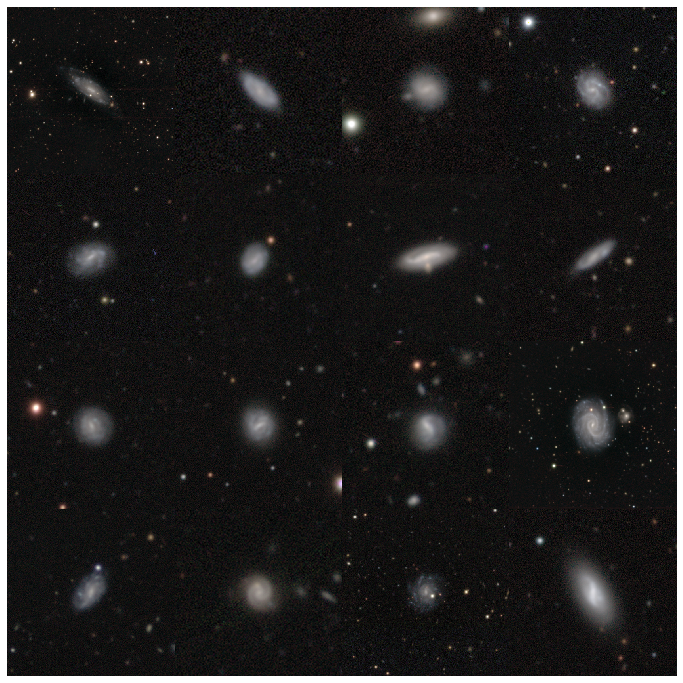

In [48]:
high_bar = df['bar_any_fraction'].rank(pct=True) > 0.5
low_bulge = df['bulge_eqn_3'].rank(pct=True) < 0.06
_ = show_galaxies(df[high_bar & low_bulge], nrows=4, ncols=4)

<Figure size 432x288 with 0 Axes>

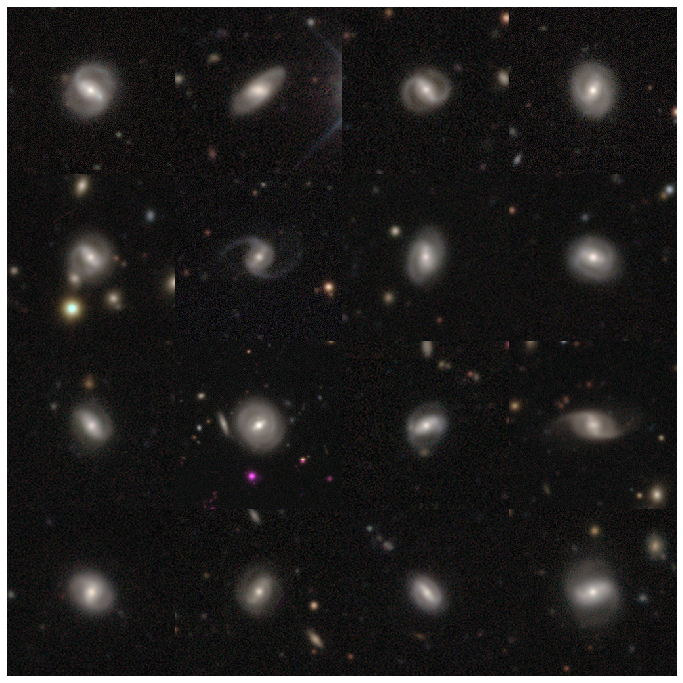

In [49]:
high_bar = df['bar_any_fraction'].rank(pct=True) > 0.8
high_bulge = df['bulge_eqn_3'].rank(pct=True) > 0.8
_ = show_galaxies(df[high_bar & high_bulge], nrows=4, ncols=4)

<Figure size 432x288 with 0 Axes>

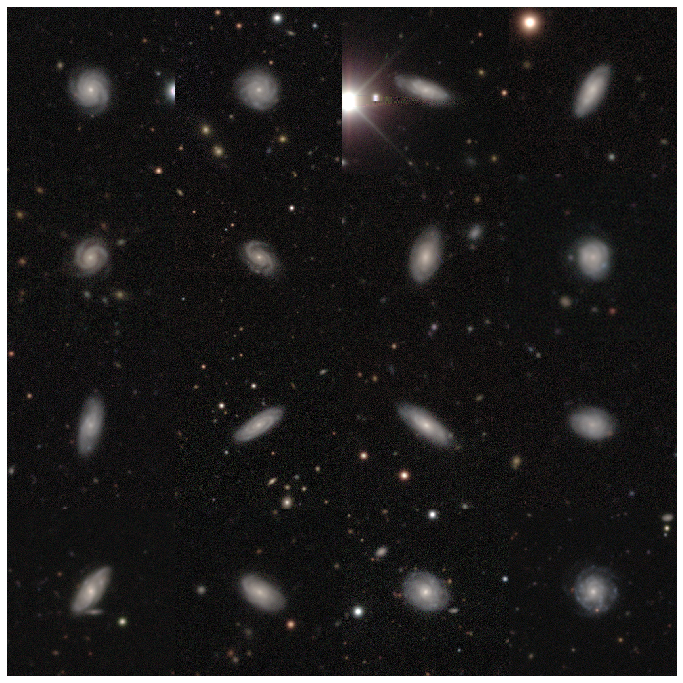

In [50]:
low_bar = df['bar_any_fraction'].rank(pct=True) < 0.4
low_bulge = df['bulge_eqn_3'].rank(pct=True) < 0.4
_ = show_galaxies(df[low_bar & low_bulge], nrows=4, ncols=4)

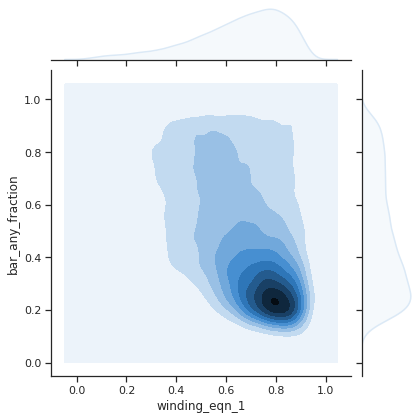

In [51]:
sns.jointplot(df['winding_eqn_1'], df['bar_any_fraction'], kind='kde')

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


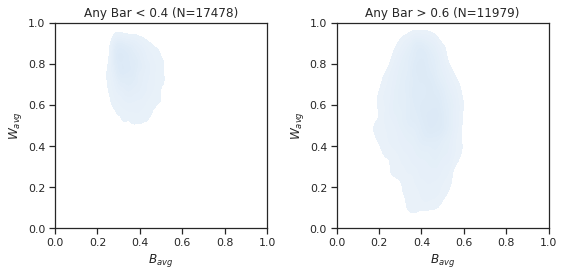

In [52]:
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(8, 4))
df['bar_any_fraction'] = df['bar_strong_fraction'] + df['bar_weak_fraction']
no_bar = df.query('bar_any_fraction < 0.4')
bar = df.query('bar_any_fraction > 0.6')
sns.kdeplot(no_bar['bulge_eqn_3'], no_bar['winding_eqn_1'], ax=ax0, shade=True, shade_lowest=False)
sns.kdeplot(bar['bulge_eqn_3'], bar['winding_eqn_1'], ax=ax1, shade=True, shade_lowest=False)
ax0.set_xlim([0, 1])
ax0.set_ylim([0, 1])
ax1.set_xlim([0, 1])
ax1.set_ylim([0, 1])
ax0.set_ylabel(r'$W_{avg}$')
ax0.set_xlabel(r'$B_{avg}$')
ax1.set_xlabel(r'$B_{avg}$')
ax1.set_ylabel(r'$W_{avg}$')
ax0.set_title(f'Any Bar < 0.4 (N={len(no_bar)})')
ax1.set_title(f'Any Bar > 0.6 (N={len(bar)})')
fig.tight_layout()

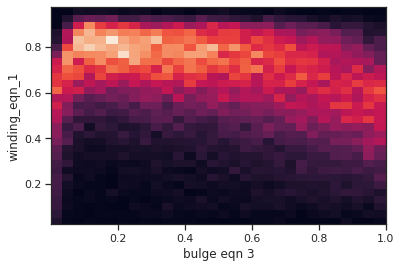

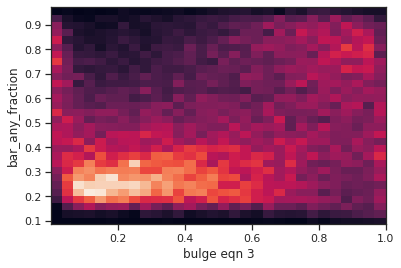

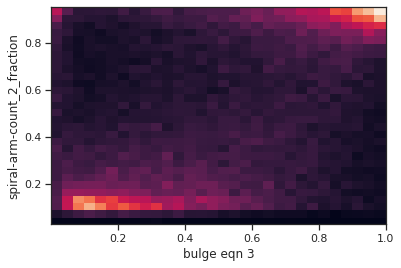

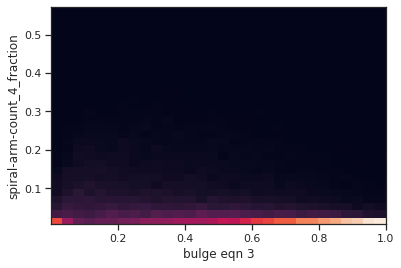

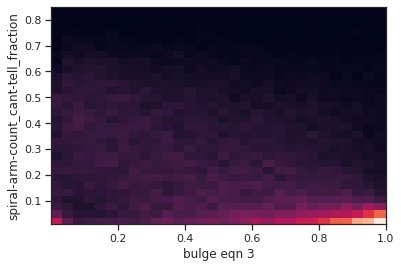

In [53]:
for col in ['winding_eqn_1', 'bar_any_fraction','spiral-arm-count_2_fraction', 'spiral-arm-count_4_fraction', 'spiral-arm-count_cant-tell_fraction']:
    plt.figure()
    plt.hist2d(df['bulge_eqn_3'].rank(pct=True), df[col], bins=[30, 30])
    plt.xlabel('bulge eqn 3')
    plt.ylabel(col)

In [54]:
# target_col = ['bulge_eqn_3']

#     plt.hist2d(df_f[target_col], df_f[col], xlim=[0., 1.], ylim=[0., 1.])

In [55]:
# target_col = ['bulge_eqn_3']
# for col in [ , ,'spiral-arm-count_cant-tell_fraction']:
#     sns.jointplot(df_f[target_col], df_f[col], xlim=[0., 1.], ylim=[0., 1.])
    

In [56]:
# assert False

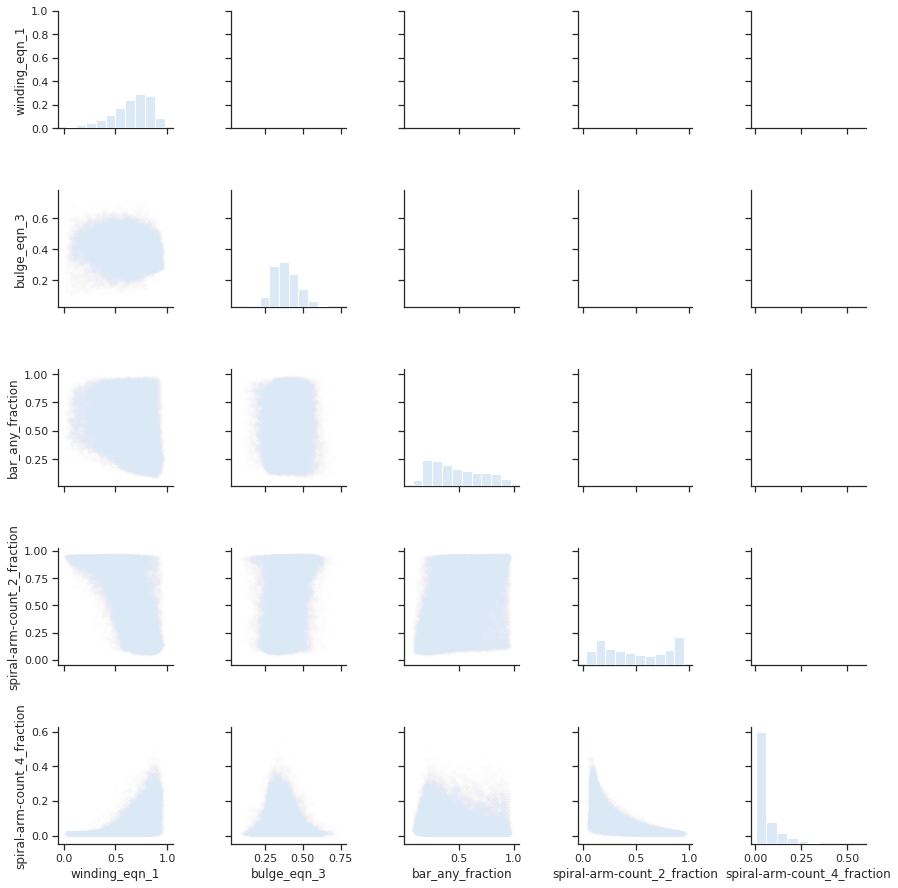

In [57]:
g = sns.PairGrid(df[['winding_eqn_1','bulge_eqn_3', 'bar_any_fraction', 'spiral-arm-count_2_fraction', 'spiral-arm-count_4_fraction',]])
# g.map_lower(lambda *args, **kwargs: plt.scatter(*args, **kwargs, alpha=.005, marker='+'))
g.map_lower(lambda *args, **kwargs: plt.scatter(*args, **kwargs, alpha=.005, marker='+'))
g.map_diag(plt.hist)

In [58]:
disky = (df['bar_any_fraction'] < 0.6) & (df['spiral-arm-count_2_fraction'] < 0.6)
grand = (df['bar_any_fraction'] > 0.2) & (df['spiral-arm-count_2_fraction'] > 0.8)

df['pop'] = 'neither'
df['pop'][disky] = 'disky'
df['pop'][grand] = 'grand'

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/pandas/core/generic.py:8765: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

In [59]:
df['pop'].value_counts()

disky      19299
neither    10225
grand       9541
Name: pop, dtype: int64

<Figure size 432x288 with 0 Axes>

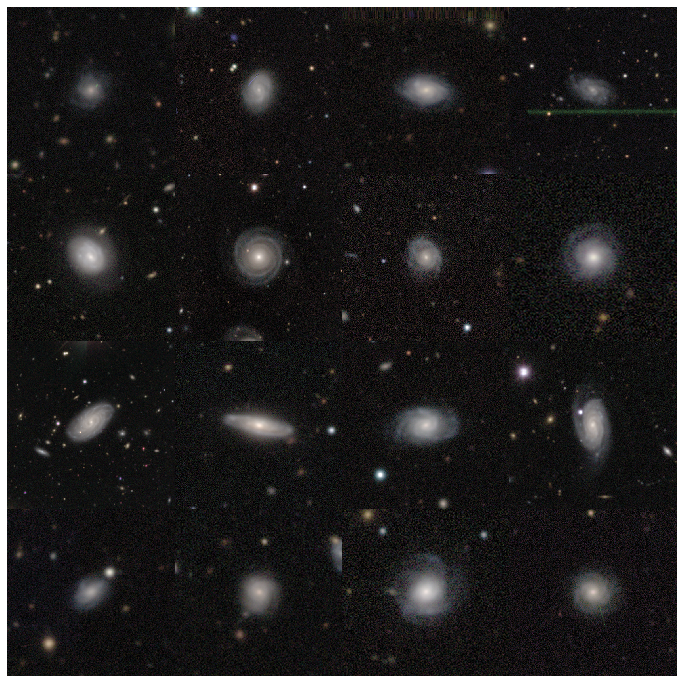

In [60]:
_ = show_galaxies(df.query('pop == "disky"').sample(100), nrows=4, ncols=4)

<Figure size 432x288 with 0 Axes>

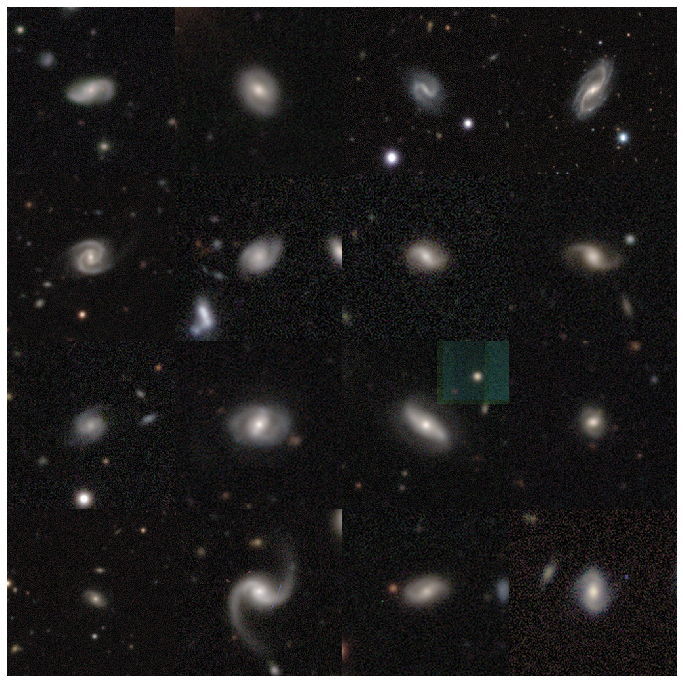

In [61]:
_ = show_galaxies(df.query('pop == "grand"').sample(100), nrows=4, ncols=4)

<Figure size 432x288 with 0 Axes>

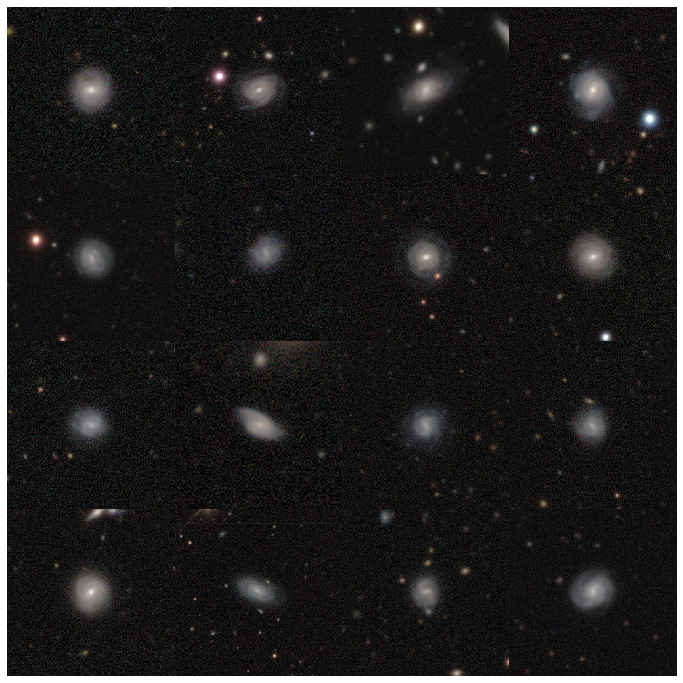

In [62]:
_ = show_galaxies(df.query('bar_weak_fraction > 0.6').query('bar_strong_fraction < 0.15').sample(100), nrows=4, ncols=4)

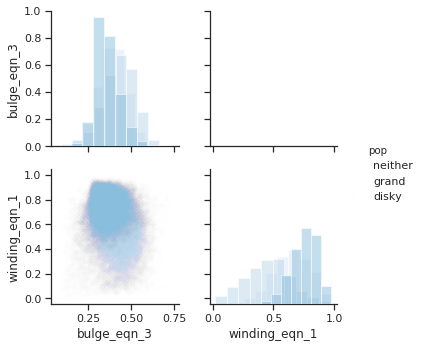

In [63]:
g = sns.PairGrid(df[['bulge_eqn_3', 'winding_eqn_1', 'pop']], hue='pop')
g.map_lower(lambda *args, **kwargs: plt.scatter(*args, **kwargs, alpha=.005, marker='+'))
g.map_diag(lambda *args, **kwargs: plt.hist(*args, **kwargs, alpha=.5, density=True))
g = g.add_legend()  # order of blue, red, green

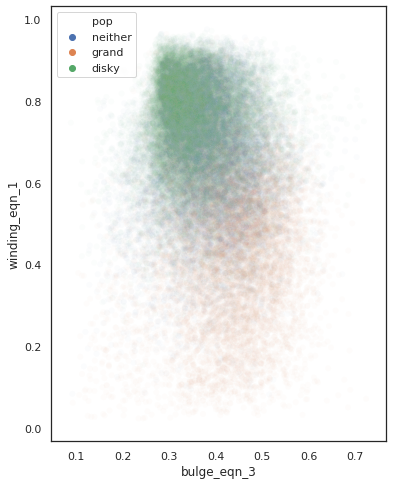

In [82]:
sns.set_style('white')
fig, ax = plt.subplots(figsize=(6, 8))
sns.scatterplot(data=df[['winding_eqn_1','bulge_eqn_3', 'pop']], y='winding_eqn_1', x='bulge_eqn_3', hue='pop', alpha=.02)

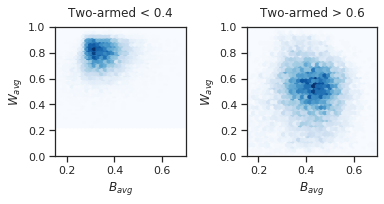

In [86]:
sns.set_context('notebook')
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(5.5, 3))
not_grand = df[df['spiral-arm-count_2_fraction'] < 0.4]
grand = df[df['spiral-arm-count_2_fraction'] > 0.6]
alpha = .01
# sns.scatterplot(no_bar['bulge_eqn_3'], no_bar['winding_eqn_1'], ax=ax0, alpha=alpha)
# sns.scatterplot(bar['bulge_eqn_3'], bar['winding_eqn_1'], ax=ax1, alpha=alpha)
# sns.kdeplot(no_bar['bulge_eqn_3'], no_bar['winding_eqn_1'], ax=ax0, shade=True, shade_lowest=False)
# sns.kdeplot(bar['bulge_eqn_3'], bar['winding_eqn_1'], ax=ax1, shade=True, shade_lowest=False)
gridsize = 40
ax0.hexbin(not_grand['bulge_eqn_3'], not_grand['winding_eqn_1'], cmap=plt.get_cmap('Blues'), gridsize=gridsize)
ax1.hexbin(grand['bulge_eqn_3'], grand['winding_eqn_1'], cmap=plt.get_cmap('Blues'), gridsize=gridsize)
xlim = [.15, .7]
ax0.set_xlim(xlim)
ax0.set_ylim([0, 1])
ax1.set_xlim(xlim)
ax1.set_ylim([0, 1])
ax0.set_ylabel(r'$W_{avg}$')
ax0.set_xlabel(r'$B_{avg}$')
ax1.set_xlabel(r'$B_{avg}$')
ax1.set_ylabel(r'$W_{avg}$')
ax0.set_title(f'Two-armed < 0.4', pad=10.)
ax1.set_title(f'Two-armed > 0.6', pad=10.)
# ax0.set_title(f'Any Bar (ML) < 0.4 (N={len(no_bar)})', pad=15.)
# ax1.set_title(f'Any Bar (ML) > 0.6 (N={len(bar)})', pad=15.)
fig.tight_layout()
fig.savefig('two_armed_split.pdf')

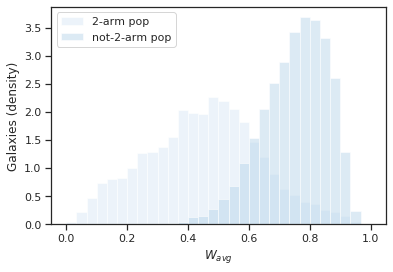

In [65]:
bins = 30
plt.hist(df.query('pop == "grand"')['winding_eqn_1'], density=True, alpha=.5, label='2-arm pop', bins=bins, range=[0., 1.])
plt.hist(df.query('pop == "disky"')['winding_eqn_1'], density=True, alpha=.5, label='not-2-arm pop',bins=bins, range=[0., 1.])
plt.xlabel(r'$W_{avg}$')
plt.ylabel('Galaxies (density)')
plt.legend()

In [66]:
df[df['spiral-arm-count_2_fraction'] > 0.8]['winding_eqn_1']

15        0.567361
21        0.446310
143       0.484225
182       0.577990
194       0.595357
            ...   
309330    0.328414
309370    0.624342
309378    0.064385
309381    0.436328
309393    0.554056
Name: winding_eqn_1, Length: 9582, dtype: float64

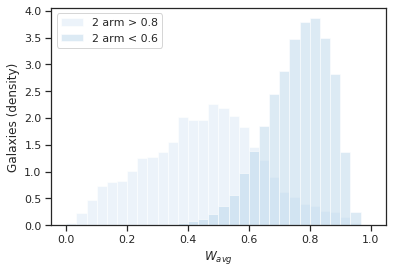

In [67]:
bins = 30
plt.hist(df[df['spiral-arm-count_2_fraction'] > 0.8]['winding_eqn_1'], density=True, alpha=.5, label='2 arm > 0.8', bins=bins, range=[0., 1.])
plt.hist(df[df['spiral-arm-count_2_fraction'] < 0.5]['winding_eqn_1'], density=True, alpha=.5, label='2 arm < 0.6',bins=bins, range=[0., 1.])
plt.xlabel(r'$W_{avg}$')
plt.ylabel('Galaxies (density)')
plt.legend()

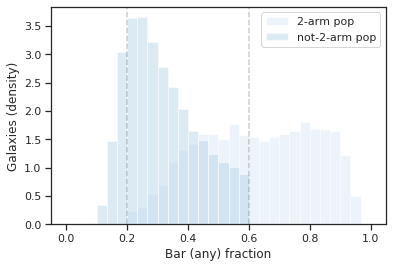

In [68]:
bins = 30
plt.hist(df.query('pop == "grand"')['bar_any_fraction'], density=True, alpha=.5, label='2-arm pop', bins=bins, range=[0., 1.])
plt.hist(df.query('pop == "disky"')['bar_any_fraction'], density=True, alpha=.5, label='not-2-arm pop',bins=bins, range=[0., 1.])
plt.xlabel(r'Bar (any) fraction')
plt.ylabel('Galaxies (density)')
plt.axvline(0.2, color='k', linestyle='--', alpha=.2)
plt.axvline(0.6, color='k', linestyle='--', alpha=.2)
plt.legend()

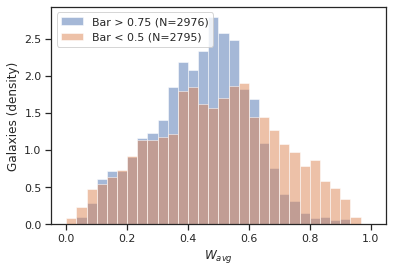

In [96]:
grand = df.query('pop == "grand"')
no_bar = grand.query('bar_any_fraction < 0.5')
bar = grand.query('bar_any_fraction > 0.75')

bins = 30
alpha = 0.5
plt.hist(bar['winding_eqn_1'], density=True, bins=bins, range=[0., 1.], alpha=alpha, label='Bar > 0.75 (N={})'.format(len(bar)))
plt.hist(no_bar['winding_eqn_1'], density=True, bins=bins, range=[0., 1.], alpha=alpha, label='Bar < 0.5 (N={})'.format(len(no_bar)))
plt.xlabel(r'$W_{avg}$')
plt.ylabel('Galaxies (density)')
plt.legend()

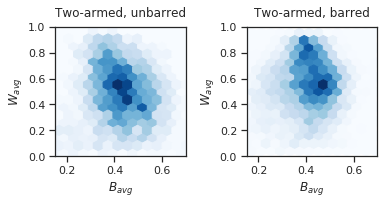

In [100]:
sns.set_context('notebook')
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(5.5, 3))
alpha = .01
# sns.scatterplot(no_bar['bulge_eqn_3'], no_bar['winding_eqn_1'], ax=ax0, alpha=alpha)
# sns.scatterplot(bar['bulge_eqn_3'], bar['winding_eqn_1'], ax=ax1, alpha=alpha)
# sns.kdeplot(no_bar['bulge_eqn_3'], no_bar['winding_eqn_1'], ax=ax0, shade=True, shade_lowest=False)
# sns.kdeplot(bar['bulge_eqn_3'], bar['winding_eqn_1'], ax=ax1, shade=True, shade_lowest=False)
gridsize = 15
ax0.hexbin(no_bar['bulge_eqn_3'], no_bar['winding_eqn_1'], cmap=plt.get_cmap('Blues'), gridsize=gridsize)
ax1.hexbin(bar['bulge_eqn_3'], bar['winding_eqn_1'], cmap=plt.get_cmap('Blues'), gridsize=gridsize)
xlim = [.15, .7]
ax0.set_xlim(xlim)
ax0.set_ylim([0, 1])
ax1.set_xlim(xlim)
ax1.set_ylim([0, 1])
ax0.set_ylabel(r'$W_{avg}$')
ax0.set_xlabel(r'$B_{avg}$')
ax1.set_xlabel(r'$B_{avg}$')
ax1.set_ylabel(r'$W_{avg}$')
ax0.set_title(f'Two-armed, unbarred', pad=10.)
ax1.set_title(f'Two-armed, barred', pad=10.)
# ax0.set_title(f'Any Bar (ML) < 0.4 (N={len(no_bar)})', pad=15.)
# ax1.set_title(f'Any Bar (ML) > 0.6 (N={len(bar)})', pad=15.)
fig.tight_layout()
# fig.savefig('two_armed_split.pdf')

Text(0.5, 0, 'Bar (any) fraction')

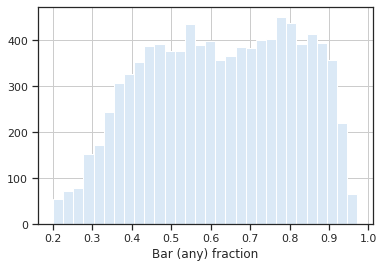

In [70]:
sns.set_style('ticks')
grand['bar_any_fraction'].hist(bins=30)
plt.xlabel('Bar (any) fraction')

<Figure size 432x288 with 0 Axes>

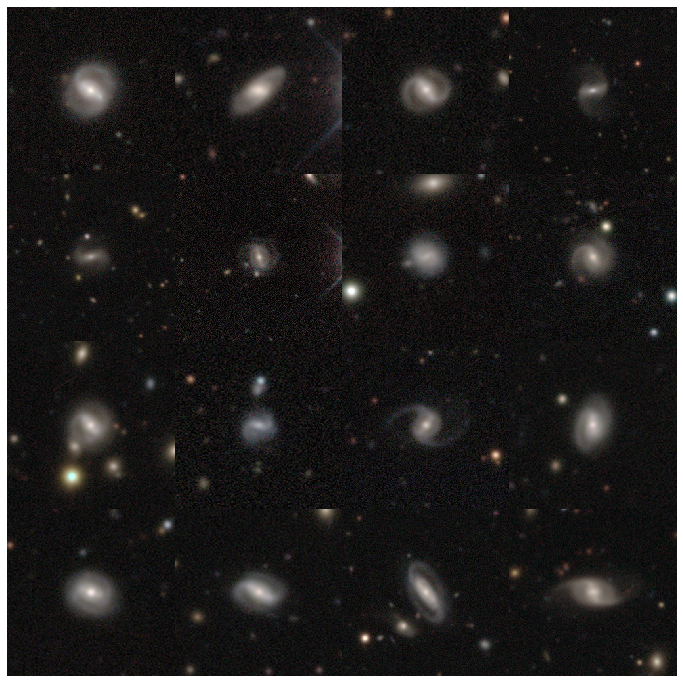

In [71]:
_ = show_galaxies(bar, nrows=4, ncols=4)

<Figure size 432x288 with 0 Axes>

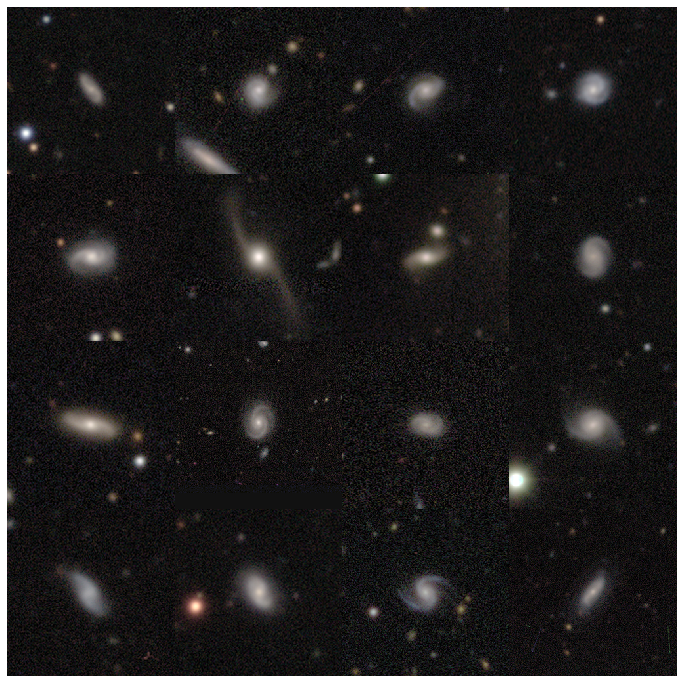

In [72]:
_ = show_galaxies(no_bar.sample(100), nrows=4, ncols=4)

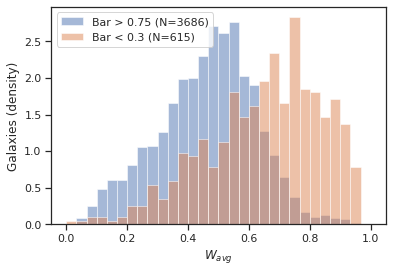

In [101]:
grand = df[df['spiral-arm-count_2_fraction'] > 0.7]
no_bar = grand.query('bar_any_fraction < 0.3')
bar = grand.query('bar_any_fraction > 0.75')

bins = 30
alpha = 0.5
plt.hist(bar['winding_eqn_1'], density=True, bins=bins, range=[0., 1.], alpha=alpha, label='Bar > 0.75 (N={})'.format(len(bar)))
plt.hist(no_bar['winding_eqn_1'], density=True, bins=bins, range=[0., 1.], alpha=alpha, label='Bar < 0.3 (N={})'.format(len(no_bar)))
plt.xlabel(r'$W_{avg}$')
plt.ylabel('Galaxies (density)')
plt.legend()

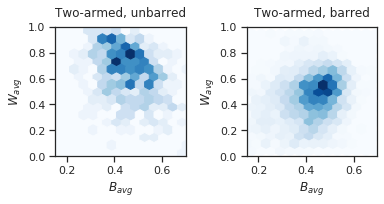

In [102]:
sns.set_context('notebook')
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(5.5, 3))
alpha = .01
# sns.scatterplot(no_bar['bulge_eqn_3'], no_bar['winding_eqn_1'], ax=ax0, alpha=alpha)
# sns.scatterplot(bar['bulge_eqn_3'], bar['winding_eqn_1'], ax=ax1, alpha=alpha)
# sns.kdeplot(no_bar['bulge_eqn_3'], no_bar['winding_eqn_1'], ax=ax0, shade=True, shade_lowest=False)
# sns.kdeplot(bar['bulge_eqn_3'], bar['winding_eqn_1'], ax=ax1, shade=True, shade_lowest=False)
gridsize = 15
ax0.hexbin(no_bar['bulge_eqn_3'], no_bar['winding_eqn_1'], cmap=plt.get_cmap('Blues'), gridsize=gridsize)
ax1.hexbin(bar['bulge_eqn_3'], bar['winding_eqn_1'], cmap=plt.get_cmap('Blues'), gridsize=gridsize)
xlim = [.15, .7]
ax0.set_xlim(xlim)
ax0.set_ylim([0, 1])
ax1.set_xlim(xlim)
ax1.set_ylim([0, 1])
ax0.set_ylabel(r'$W_{avg}$')
ax0.set_xlabel(r'$B_{avg}$')
ax1.set_xlabel(r'$B_{avg}$')
ax1.set_ylabel(r'$W_{avg}$')
ax0.set_title(f'Two-armed, unbarred', pad=10.)
ax1.set_title(f'Two-armed, barred', pad=10.)
# ax0.set_title(f'Any Bar (ML) < 0.4 (N={len(no_bar)})', pad=15.)
# ax1.set_title(f'Any Bar (ML) > 0.6 (N={len(bar)})', pad=15.)
fig.tight_layout()
# fig.savefig('two_armed_split.pdf')

<Figure size 432x288 with 0 Axes>

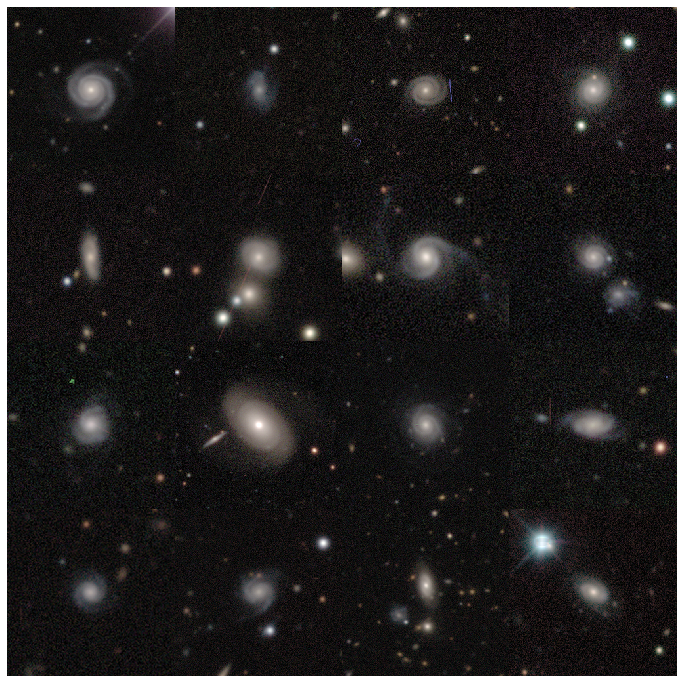

In [74]:
_ = show_galaxies(no_bar.sample(100), nrows=4, ncols=4)

<Figure size 432x288 with 0 Axes>

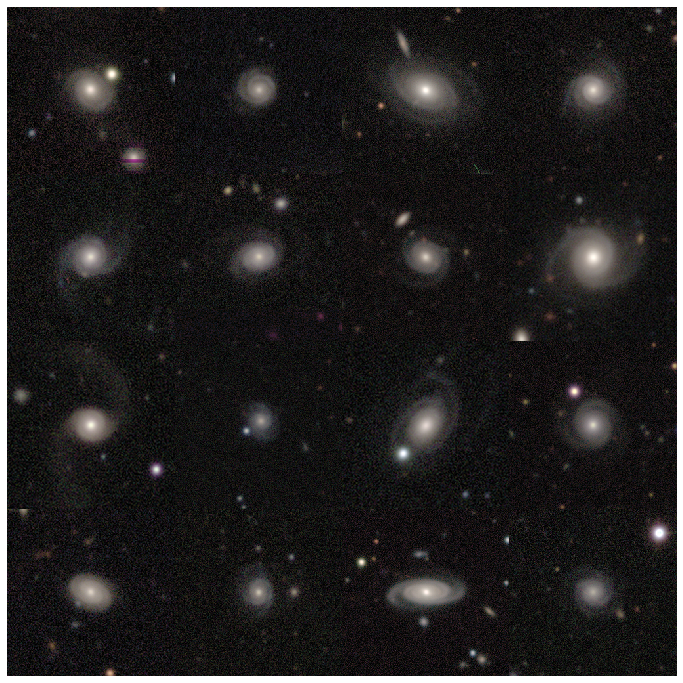

In [75]:
_ = show_galaxies(no_bar.query('bar_any_fraction < 0.2').sample(50), nrows=4, ncols=4)

39065 6373


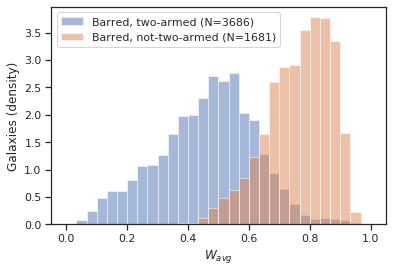

In [103]:
bar = df.query('bar_any_fraction > 0.75')
grand = bar[bar['spiral-arm-count_2_fraction'] > 0.7]
not_grand = bar[bar['spiral-arm-count_2_fraction'] < 0.5]  # lowered from .6, as that still got a few two-armed spirals
print(len(df), len(bar))

bins = 30
alpha = 0.5
plt.hist(grand['winding_eqn_1'], density=True, bins=bins, range=[0., 1.], alpha=alpha, label='Barred, two-armed (N={})'.format(len(grand)))
plt.hist(not_grand['winding_eqn_1'], density=True, bins=bins, range=[0., 1.], alpha=alpha, label='Barred, not-two-armed (N={})'.format(len(not_grand)))
plt.xlabel(r'$W_{avg}$')
plt.ylabel('Galaxies (density)')
plt.legend()

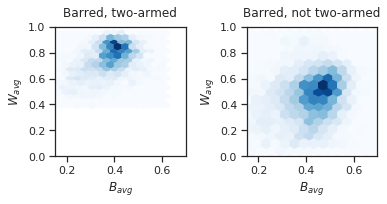

In [104]:
sns.set_context('notebook')
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(5.5, 3))
alpha = .01

gridsize = 15
ax0.hexbin(not_grand['bulge_eqn_3'], not_grand['winding_eqn_1'], cmap=plt.get_cmap('Blues'), gridsize=gridsize)
ax1.hexbin(grand['bulge_eqn_3'], grand['winding_eqn_1'], cmap=plt.get_cmap('Blues'), gridsize=gridsize)
xlim = [.15, .7]
ax0.set_xlim(xlim)
ax0.set_ylim([0, 1])
ax1.set_xlim(xlim)
ax1.set_ylim([0, 1])
ax0.set_ylabel(r'$W_{avg}$')
ax0.set_xlabel(r'$B_{avg}$')
ax1.set_xlabel(r'$B_{avg}$')
ax1.set_ylabel(r'$W_{avg}$')
ax0.set_title(f'Barred, two-armed', pad=10.)
ax1.set_title(f'Barred, not two-armed', pad=10.)
# ax0.set_title(f'Any Bar (ML) < 0.4 (N={len(no_bar)})', pad=15.)
# ax1.set_title(f'Any Bar (ML) > 0.6 (N={len(bar)})', pad=15.)
fig.tight_layout()
# fig.savefig('two_armed_split.pdf')

<Figure size 432x288 with 0 Axes>

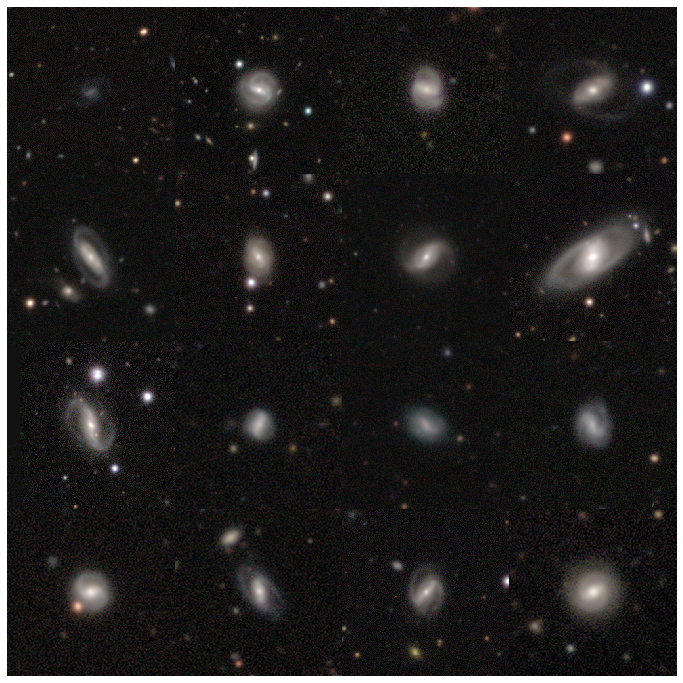

In [77]:
_ = show_galaxies(grand.sample(50), nrows=4, ncols=4)

<Figure size 432x288 with 0 Axes>

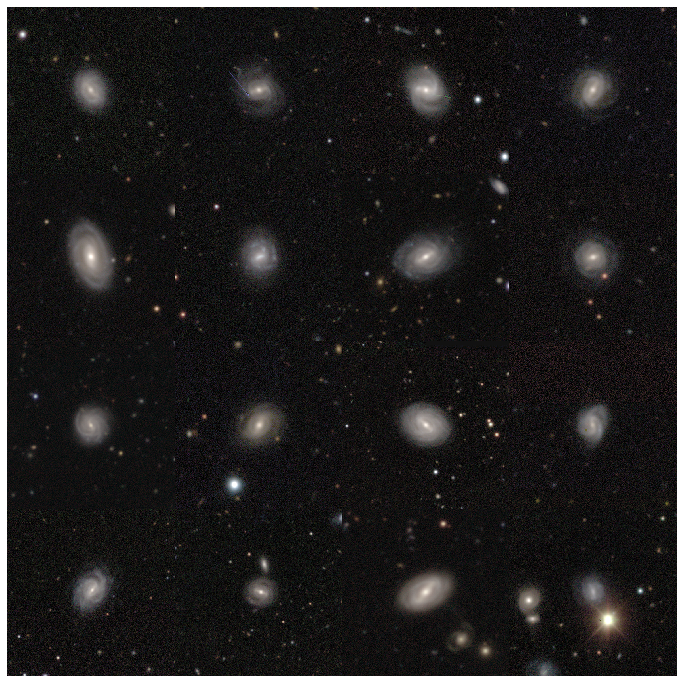

In [78]:
_ = show_galaxies(not_grand.sample(50), nrows=4, ncols=4)

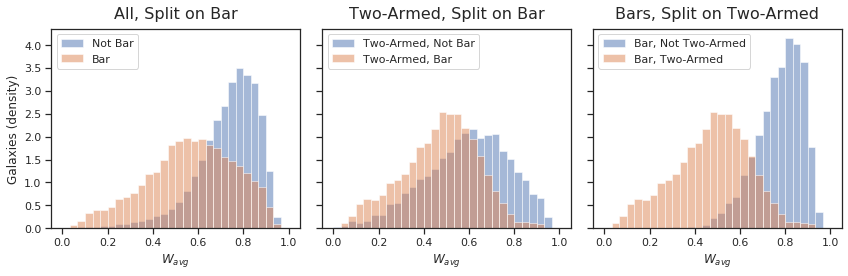

In [168]:
min_2 = 0.6
max_2 = 0.4

min_bar = 0.6
max_bar = 0.4

grand = df[df['spiral-arm-count_2_fraction'] > min_2]
grand_no_bar = grand.query('bar_any_fraction < 0.4')
grand_bar = grand.query('bar_any_fraction > 0.6')

bar = df.query(f'bar_any_fraction > {min_bar}')
not_bar = df.query(f'bar_any_fraction < {max_bar}')  # to replicate M19
bar_grand = bar[bar['spiral-arm-count_2_fraction'] > min_2]
bar_not_grand = bar[bar['spiral-arm-count_2_fraction'] < max_2]  # lowered from .6, as that still got a few two-armed spirals

fig, (ax0, ax1, ax2) = plt.subplots(ncols=3, figsize=(12, 4), sharex=True, sharey=True)
bins = 30
alpha = 0.5

ax0.hist(not_bar['winding_eqn_1'], density=True, bins=bins, range=[0., 1.], alpha=alpha, label='Not Bar')
ax0.hist(bar['winding_eqn_1'], density=True, bins=bins, range=[0., 1.], alpha=alpha, label='Bar')
ax0.set_xlabel(r'$W_{avg}$')
ax0.set_ylabel('Galaxies (density)')
ax0.legend()
ax0.set_title('All, Split on Bar', fontsize=16, pad=10)

ax1.hist(grand_no_bar['winding_eqn_1'], density=True, bins=bins, range=[0., 1.], alpha=alpha, label='Two-Armed, Not Bar')
ax1.hist(grand_bar['winding_eqn_1'], density=True, bins=bins, range=[0., 1.], alpha=alpha, label='Two-Armed, Bar')
ax1.set_xlabel(r'$W_{avg}$')
ax1.legend(loc='upper left')
ax1.set_title('Two-Armed, Split on Bar', fontsize=16, pad=10)

ax2.hist(bar_not_grand['winding_eqn_1'], density=True, bins=bins, range=[0., 1.], alpha=alpha, label=f'Bar, Not Two-Armed')
ax2.hist(bar_grand['winding_eqn_1'], density=True, bins=bins, range=[0., 1.], alpha=alpha, label=f'Bar, Two-Armed')
ax2.set_xlabel(r'$W_{avg}$')
ax2.legend()
ax2.set_title('Bars, Split on Two-Armed', fontsize=16, pad=10)

fig.tight_layout()
fig.savefig('winding_marginals.pdf')

<Figure size 432x288 with 0 Axes>

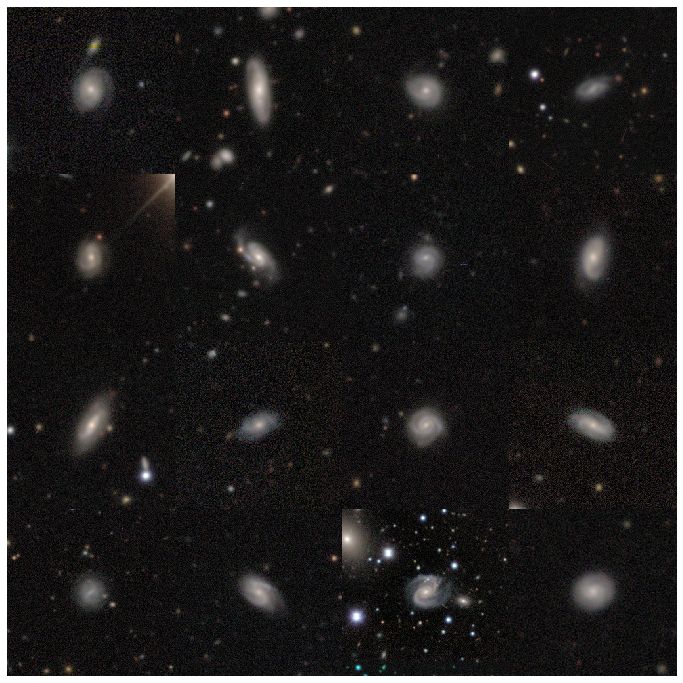

In [155]:
_ = show_galaxies(df[(df['spiral-arm-count_2_fraction'] > 0.7) & (df['spiral-arm-count_2_fraction'] < 0.8)].sample(50), nrows=4, ncols=4)

<Figure size 432x288 with 0 Axes>

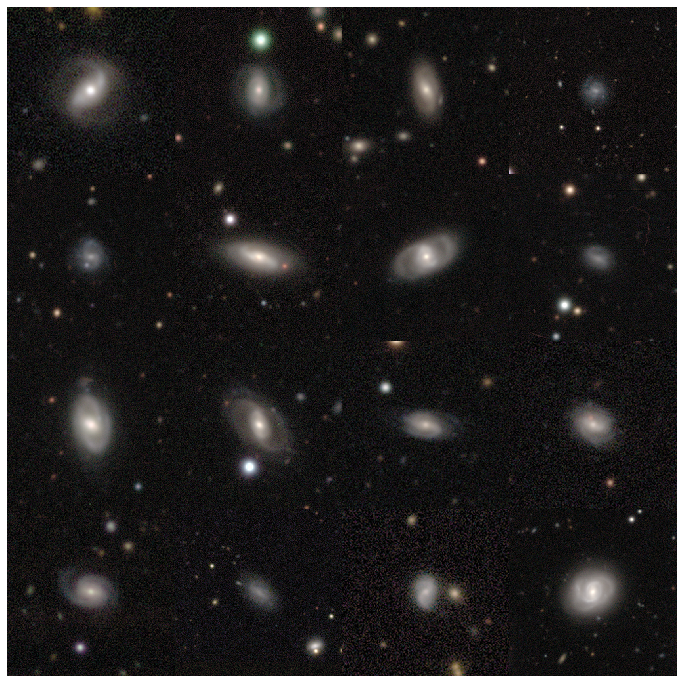

In [158]:
_ = show_galaxies(df[(df['bar_any_fraction'] > 0.6) & (df['bar_any_fraction'] < 0.7)].sample(50), nrows=4, ncols=4)

<Figure size 432x288 with 0 Axes>

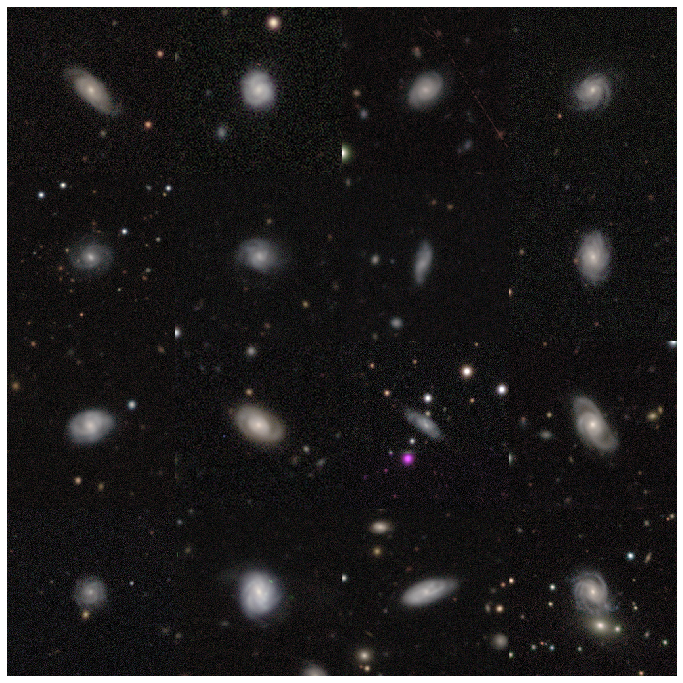

In [159]:
_ = show_galaxies(df[(df['bar_any_fraction'] > 0.3) & (df['bar_any_fraction'] < 0.4)].sample(50), nrows=4, ncols=4)